# Watershed Delineation with PyGILE-Plus

## Overview

This notebook demonstrates automated watershed delineation using Digital Elevation Models (DEMs) and WhiteboxTools.

## What is Watershed Delineation?

A watershed, also known as a drainage basin or catchment, is an area where all water drains to a common outlet point called a pour point. Understanding watershed boundaries is critical for hydrology applications such as water flow modeling and flood prediction, environmental studies including pollutant transport and ecosystem boundaries, land use planning to understand drainage patterns, and agriculture for irrigation system design and erosion management.

## The Delineation Process

The watershed delineation workflow involves several steps. First, depressions in the DEM are filled to remove sinks that would trap flow. Next, flow direction is calculated to determine where water flows from each cell. Flow accumulation is then computed to show how much upstream area drains through each cell. From this, a stream network is extracted based on a flow accumulation threshold. A pour point is selected to mark the watershed outlet, and finally, all cells that contribute flow upstream of the pour point are traced to define the watershed boundary.

## Setup and Imports

This cell imports the required Python libraries for watershed delineation.

**Libraries used:**
- `rasterio` and `rasterio.mask`: Reading and clipping raster DEM data
- `geopandas`: Creating and manipulating vector geometries (pour points, watershed boundaries)
- `shapely`: Geometric operations for converting raster to vector
- `folium`: Creating interactive maps for pour point selection
- `pyproj.Transformer`: Converting coordinates between CRS (WGS84 and projected)
- `matplotlib`: Visualizing the watershed results

The cell also loads the configuration from `watershed_analysis.json` created in Notebook 01 and creates the output directories.

In [1]:
import json
import os
import subprocess
import numpy as np
import rasterio
import rasterio.mask
from rasterio.features import shapes
import geopandas as gpd
from shapely.geometry import shape
import matplotlib.pyplot as plt
import folium
from folium.plugins import MousePosition
from pyproj import Transformer
import warnings
warnings.filterwarnings('ignore')

# Load configuration
with open('watershed_analysis.json', 'r') as f:
    config = json.load(f)

# Create output directories
os.makedirs(config["temp_dir"], exist_ok=True)
os.makedirs(config["output_dir"], exist_ok=True)

print("Setup complete")
print(f"DEM: {config['dem_path']}")
print(f"Output: {config['output_dir']}")

Setup complete
DEM: clipped_dem.tif
Output: results


## Watershed Delineation Class

The `WatershedDelineator` class encapsulates the complete watershed delineation workflow. It contains the following methods:

**`__init__(dem_path)`**: Initializes the delineator by reading DEM metadata (cell size, CRS, bounds) and setting up coordinate transformers between the DEM's native CRS and WGS84 for the interactive map.

**`get_pour_point()`**: Creates an interactive Folium map showing the DEM boundary. The user clicks on the map to get coordinates, then enters them when prompted. The `MousePosition` plugin shows cursor coordinates and `LatLngPopup` displays clicked locations.

**`delineate_watershed(lat, lng)`**: Executes the 8-step WhiteboxTools workflow:
1. `FillDepressions`: Removes sinks that would trap flow
2. `D8Pointer`: Calculates flow direction using D8 algorithm
3. `D8FlowAccumulation`: Computes upstream contributing area
4. `ExtractStreams`: Creates stream network from flow accumulation threshold
5. `SnapPourPoints`: Snaps user's pour point to nearest stream cell
6. `Watershed`: Delineates all cells draining to the pour point
7. Raster to vector conversion using `rasterio.features.shapes`
8. Clips DEM to watershed boundary using `rasterio.mask`

**`visualize_results()`**: Creates a side-by-side matplotlib figure showing the original DEM with watershed boundary overlay and the clipped watershed DEM.

In [2]:
class WatershedDelineator:
    """
    Automated watershed delineation from DEM data using WhiteboxTools
    """
    
    def __init__(self, dem_path):
        """Initialize delineator with DEM"""
        self.dem_path = dem_path
        self.temp_dir = config["temp_dir"]
        
        # Read DEM metadata
        with rasterio.open(dem_path) as src:
            self.cell_size = src.res[0]
            self.crs = src.crs
            bounds = src.bounds
            
            # Setup coordinate transformers
            self.to_wgs84 = Transformer.from_crs(self.crs, config["target_crs"], always_xy=True)
            self.from_wgs84 = Transformer.from_crs(config["target_crs"], self.crs, always_xy=True)
            
            # Transform bounds to WGS84
            minx, miny = self.to_wgs84.transform(bounds.left, bounds.bottom)
            maxx, maxy = self.to_wgs84.transform(bounds.right, bounds.top)
            self.bounds_wgs84 = {'minx': minx, 'miny': miny, 'maxx': maxx, 'maxy': maxy}
    
    def get_pour_point(self):
        """Create interactive map for pour point selection"""
        center_lat = (self.bounds_wgs84['miny'] + self.bounds_wgs84['maxy']) / 2
        center_lng = (self.bounds_wgs84['minx'] + self.bounds_wgs84['maxx']) / 2
        
        # Create map
        m = folium.Map(location=[center_lat, center_lng], zoom_start=13)
        
        # Add DEM boundary
        bounds_coords = [
            [self.bounds_wgs84['miny'], self.bounds_wgs84['minx']],
            [self.bounds_wgs84['miny'], self.bounds_wgs84['maxx']],
            [self.bounds_wgs84['maxy'], self.bounds_wgs84['maxx']],
            [self.bounds_wgs84['maxy'], self.bounds_wgs84['minx']]
        ]
        folium.Polygon(bounds_coords, color='blue', weight=2, fill=True, fillOpacity=0.1).add_to(m)
        
        MousePosition().add_to(m)
        folium.LatLngPopup().add_to(m)
        
        # Display map
        try:
            from IPython.display import display
            display(m)
        except ImportError:
            m.save("pour_point_map.html")
            print("Map saved to pour_point_map.html")
        
        # Get pour point from user
        while True:
            try:
                lat = float(input("Enter Latitude: ").strip())
                lng = float(input("Enter Longitude: ").strip())
                
                if (self.bounds_wgs84['miny'] <= lat <= self.bounds_wgs84['maxy'] and 
                    self.bounds_wgs84['minx'] <= lng <= self.bounds_wgs84['maxx']):
                    if input(f"Use Lat={lat:.6f}, Lng={lng:.6f}? (y/n): ").lower() == 'y':
                        return lat, lng
                else:
                    print("Point outside DEM bounds! Try again.")
            except ValueError:
                print("Invalid input! Try again.")
    
    def delineate_watershed(self, lat, lng):
        """Perform watershed delineation using WhiteboxTools"""
        # Transform pour point to DEM projection
        x_proj, y_proj = self.from_wgs84.transform(lng, lat)
        
        # Create pour point shapefile
        gdf = gpd.GeoDataFrame(
            {'id': [1]}, 
            geometry=gpd.points_from_xy([x_proj], [y_proj]), 
            crs=self.crs
        )
        pour_point_path = os.path.join(self.temp_dir, 'pour_point.shp')
        gdf.to_file(pour_point_path)
        
        # Copy DEM to temp directory
        import shutil
        dem_temp = os.path.join(self.temp_dir, 'dem.tif')
        shutil.copy2(self.dem_path, dem_temp)
        
        # WhiteboxTools workflow
        print("\nStep 1: Filling depressions...")
        self._run_whitebox('FillDepressions', {
            'dem': dem_temp,
            'output': os.path.join(self.temp_dir, 'dem_filled.tif'),
            'fix_flats': 'true'
        })
        
        print("Step 2: Calculating D8 flow pointer...")
        self._run_whitebox('D8Pointer', {
            'dem': os.path.join(self.temp_dir, 'dem_filled.tif'),
            'output': os.path.join(self.temp_dir, 'd8_pointer.tif')
        })
        
        print("Step 3: Calculating flow accumulation...")
        self._run_whitebox('D8FlowAccumulation', {
            'input': os.path.join(self.temp_dir, 'd8_pointer.tif'),
            'output': os.path.join(self.temp_dir, 'flow_accum.tif'),
            'pntr': 'true'
        })
        
        print("Step 4: Extracting stream network...")
        threshold = max(config["flow_accumulation_threshold"], 
                       int(1000 / (self.cell_size * self.cell_size)))
        self._run_whitebox('ExtractStreams', {
            'flow_accum': os.path.join(self.temp_dir, 'flow_accum.tif'),
            'output': os.path.join(self.temp_dir, 'streams.tif'),
            'threshold': threshold
        })
        
        print("Step 5: Snapping pour point to stream...")
        snap_distance = self.cell_size * 10
        self._run_whitebox('SnapPourPoints', {
            'pour_pts': pour_point_path,
            'flow_accum': os.path.join(self.temp_dir, 'flow_accum.tif'),
            'output': os.path.join(self.temp_dir, 'pour_point_snapped.shp'),
            'snap_dist': snap_distance
        })
        
        print("Step 6: Delineating watershed...")
        self._run_whitebox('Watershed', {
            'd8_pntr': os.path.join(self.temp_dir, 'd8_pointer.tif'),
            'pour_pts': os.path.join(self.temp_dir, 'pour_point_snapped.shp'),
            'output': os.path.join(self.temp_dir, 'watershed.tif')
        })
        
        print("Step 7: Converting to vector...")
        watershed_vector = self._raster_to_vector()
        
        print("Step 8: Clipping DEM to watershed...")
        clipped_dem = self._clip_dem_with_watershed(watershed_vector)
        
        return watershed_vector, clipped_dem
    
    def _run_whitebox(self, tool_name, parameters):
        """Execute WhiteboxTools command"""
        cmd = [config['whitebox_tools'], f'--run={tool_name}']
        for key, value in parameters.items():
            cmd.append(f'--{key}={value}')
        cmd.append('--verbose=false')
        
        result = subprocess.run(cmd, capture_output=True, text=True)
        if result.returncode != 0:
            raise Exception(f"WhiteboxTools {tool_name} failed: {result.stderr}")
    
    def _raster_to_vector(self):
        """Convert watershed raster to vector polygon"""
        watershed_raster = os.path.join(self.temp_dir, 'watershed.tif')
        
        with rasterio.open(watershed_raster) as src:
            data = src.read(1)
            transform = src.transform
            crs = src.crs
        
        # Vectorize
        polygons = []
        for geom, value in shapes(data.astype(np.int32), mask=data > 0, transform=transform):
            if value > 0:
                polygons.append(shape(geom))
        
        if polygons:
            gdf = gpd.GeoDataFrame({'id': range(len(polygons))}, geometry=polygons, crs=crs)
            vector_path = os.path.join(config['output_dir'], 'watershed.shp')
            gdf.to_file(vector_path)
            return vector_path
        return None
    
    def _clip_dem_with_watershed(self, watershed_vector):
        """Clip DEM to watershed boundary with proper NoData handling"""
        if not watershed_vector:
            return None
        
        watershed_gdf = gpd.read_file(watershed_vector)
        
        with rasterio.open(self.dem_path) as src:
            # Define a proper NoData value for elevation data
            nodata_value = -9999.0
            
            # Mask with explicit nodata fill value
            out_image, out_transform = rasterio.mask.mask(
                src, 
                watershed_gdf.geometry, 
                crop=True,
                nodata=nodata_value,  # Fill outside polygon with this value
                filled=True           # Return filled array, not masked
            )
            
            out_meta = src.meta.copy()
            out_meta.update({
                "driver": "GTiff",
                "height": out_image.shape[1],
                "width": out_image.shape[2],
                "transform": out_transform,
                "nodata": nodata_value,  # Set NoData in metadata
                "dtype": "float32"       # Ensure float dtype for NoData compatibility
            })
            
            # Convert to float32 if needed
            out_image = out_image.astype(np.float32)
            
            clipped_dem_path = os.path.join(config['output_dir'], 'watershed_dem.tif')
            with rasterio.open(clipped_dem_path, "w", **out_meta) as dest:
                dest.write(out_image)
            
            print(f"  NoData value set to: {nodata_value}")
            
            return clipped_dem_path
    
    def visualize_results(self, watershed_vector, clipped_dem, lat, lng):
        """Create visualization of results"""
        if not watershed_vector or not clipped_dem:
            return
        
        x_proj, y_proj = self.from_wgs84.transform(lng, lat)
        
        # Read original DEM
        with rasterio.open(self.dem_path) as src:
            original_dem = src.read(1, masked=True)
            original_extent = [src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top]
        
        # Read clipped DEM
        with rasterio.open(clipped_dem) as src:
            clipped_data = src.read(1, masked=True)
            clipped_extent = [src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top]
        
        # Read watershed and calculate area
        watershed_gdf = gpd.read_file(watershed_vector)
        area_km2 = watershed_gdf.geometry.area.sum() / 1e6
        
        # Create figure
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7))
        
        # Left: Original DEM with watershed
        im1 = ax1.imshow(original_dem, extent=original_extent, cmap='terrain', aspect='equal')
        watershed_gdf.plot(ax=ax1, facecolor='none', edgecolor='red', linewidth=2.5)
        ax1.scatter(x_proj, y_proj, c='red', s=200, marker='o', edgecolor='white', linewidth=2)
        ax1.set_title(f'Original DEM with Watershed Boundary', 
                     fontsize=14, fontweight='bold', pad=15)
        ax1.set_xlabel('Easting (m)', fontsize=11)
        ax1.set_ylabel('Northing (m)', fontsize=11)
        ax1.ticklabel_format(style='plain', useOffset=False)
        plt.setp(ax1.get_xticklabels(), rotation=30, ha='right', fontsize=9)
        plt.setp(ax1.get_yticklabels(), fontsize=9)
        ax1.grid(True, alpha=0.3)
        
        cbar1 = plt.colorbar(im1, ax=ax1, shrink=0.7, pad=0.02)
        cbar1.set_label('Elevation (m)', fontsize=11)
        
        # Right: Clipped DEM
        im2 = ax2.imshow(clipped_data, extent=clipped_extent, cmap='terrain', aspect='equal')
        ax2.scatter(x_proj, y_proj, c='red', s=200, marker='o', edgecolor='white', linewidth=2)
        ax2.set_title('Watershed DEM (Clipped)', fontsize=14, fontweight='bold', pad=15)
        ax2.set_xlabel('Easting (m)', fontsize=11)
        ax2.set_ylabel('Northing (m)', fontsize=11)
        ax2.ticklabel_format(style='plain', useOffset=False)
        plt.setp(ax2.get_xticklabels(), rotation=30, ha='right', fontsize=9)
        plt.setp(ax2.get_yticklabels(), fontsize=9)
        ax2.grid(True, alpha=0.3)
        
        cbar2 = plt.colorbar(im2, ax=ax2, shrink=0.7, pad=0.02)
        cbar2.set_label('Elevation (m)', fontsize=11)
        
        plt.tight_layout()
        viz_path = os.path.join(config["output_dir"], 'watershed_results.png')
        plt.savefig(viz_path, dpi=300, bbox_inches='tight')
        plt.show()
        plt.close()
        
        print(f"\nVisualization saved to: {viz_path}")
        return viz_path

print("WatershedDelineator class loaded")

WatershedDelineator class loaded


## Run Watershed Delineation

This cell executes the watershed delineation workflow:

1. Creates a `WatershedDelineator` instance with the DEM path from config
2. Displays an interactive map where you can click to see coordinates
3. Prompts you to enter the latitude and longitude of your pour point
4. Runs the 8-step delineation process using WhiteboxTools
5. Visualizes the results and saves outputs

**Outputs saved to the results directory:**
- `watershed.shp`: Vector polygon of the watershed boundary
- `watershed_dem.tif`: DEM clipped to the watershed extent
- `watershed_results.png`: Visualization comparing original and clipped DEM

**How to select a pour point:**
- Look at the interactive map and identify where you want the watershed outlet
- Click on the map to see the coordinates in the popup
- Enter the latitude and longitude when prompted
- The pour point will be automatically snapped to the nearest stream cell

Please select a pour point on the interactive map...


Enter Latitude:  29.4381
Enter Longitude:  80.4982
Use Lat=29.438100, Lng=80.498200? (y/n):  y



Delineating watershed for pour point: (29.438100, 80.498200)


Step 1: Filling depressions...
Step 2: Calculating D8 flow pointer...
Step 3: Calculating flow accumulation...
Step 4: Extracting stream network...
Step 5: Snapping pour point to stream...
Step 6: Delineating watershed...
Step 7: Converting to vector...
Step 8: Clipping DEM to watershed...
  NoData value set to: -9999.0

Watershed delineation successful!


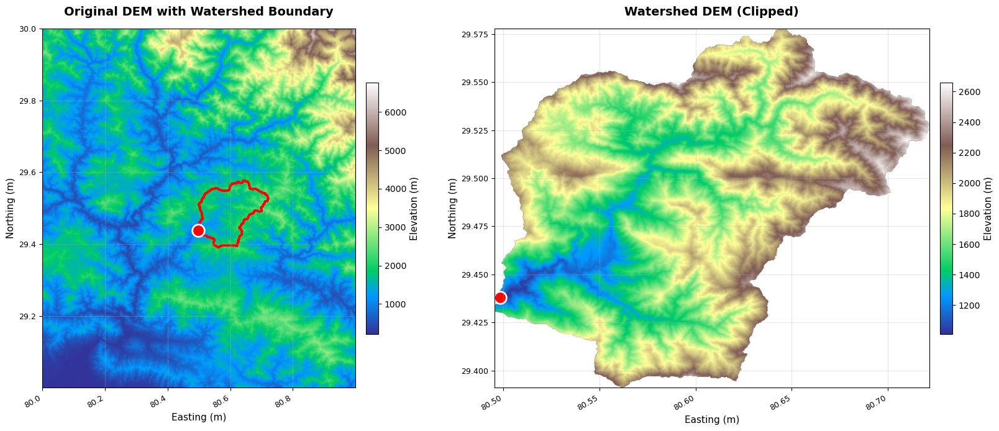


Visualization saved to: results/watershed_results.png

Results saved to: results
  - watershed.shp: Watershed boundary
  - watershed_dem.tif: Clipped DEM
  - watershed_results.png: Visualization


In [4]:
# Create delineator
delineator = WatershedDelineator(config['dem_path'])

# Get pour point from user
print("Please select a pour point on the interactive map...")
lat, lng = delineator.get_pour_point()

# Delineate watershed
print(f"\nDelineating watershed for pour point: ({lat:.6f}, {lng:.6f})\n")
watershed_vector, clipped_dem = delineator.delineate_watershed(lat, lng)

# Visualize
if watershed_vector and clipped_dem:
    print("\nWatershed delineation successful!")
    delineator.visualize_results(watershed_vector, clipped_dem, lat, lng)
    print(f"\nResults saved to: {config['output_dir']}")
    print("  - watershed.shp: Watershed boundary")
    print("  - watershed_dem.tif: Clipped DEM")
    print("  - watershed_results.png: Visualization")
else:
    print("\nWatershed delineation failed")

## 3D Terrain Visualization

This cell creates an interactive 3D surface plot of the delineated watershed using Plotly.

**Processing steps:**
1. Reads the clipped watershed DEM (`watershed_dem.tif`)
2. Masks NoData values (set to -9999) as NaN so they appear as gaps
3. Downsamples large DEMs to 500x500 for performance
4. Creates a `go.Surface` plot with earth colorscale

**Plotly features:**
- `connectgaps=False`: Preserves the watershed boundary shape by not interpolating across NoData
- Custom lighting for realistic terrain shading
- Interactive rotation, zoom, and pan
- Aspect ratio adjusted to reduce vertical exaggeration

You can rotate the 3D view by clicking and dragging, zoom with scroll wheel, and pan with right-click drag.

Original DEM size: (673, 814)
Resampled DEM size: (673, 814)
Elevation range: 1011.7 - 2660.1 m


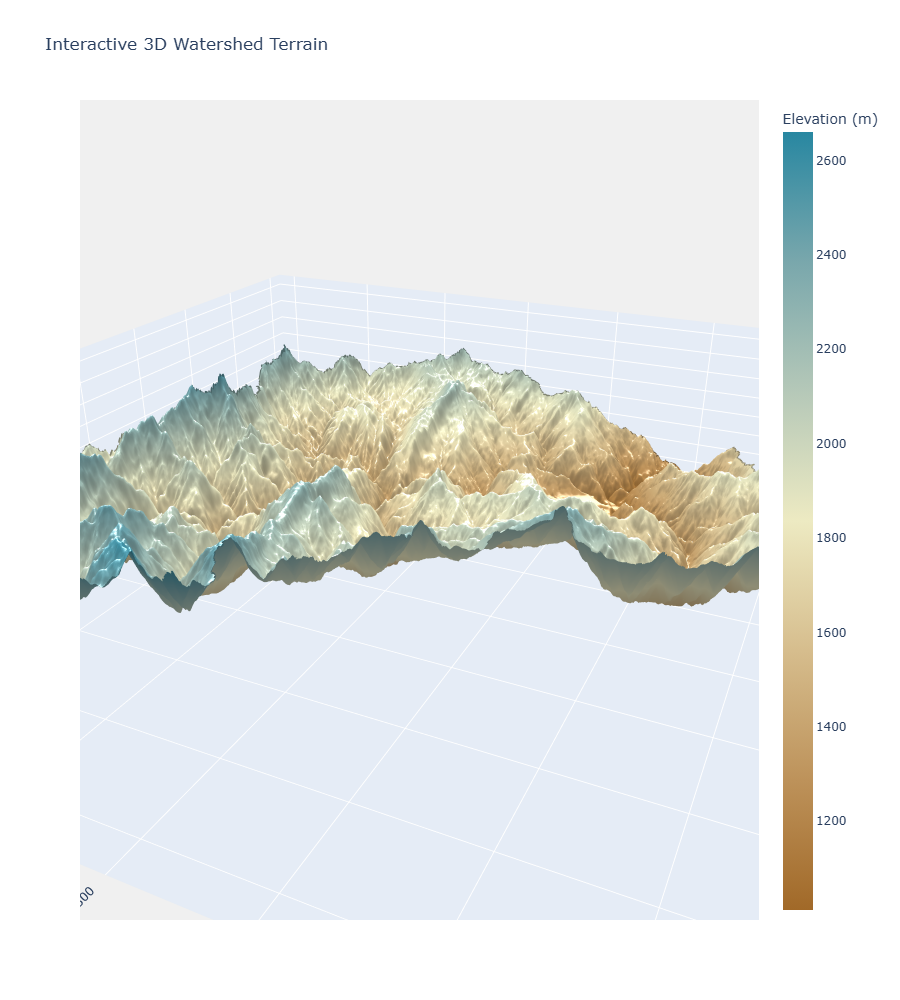

3D visualization created.


In [6]:
import plotly.graph_objects as go
import numpy as np
from scipy.ndimage import zoom

# Read the CLIPPED watershed DEM
clipped_dem_path = os.path.join(config['output_dir'], 'watershed_dem.tif')

with rasterio.open(clipped_dem_path) as src:
    elevation = src.read(1).astype(float)
    nodata = src.nodata
    
    # Mask NoData values as NaN
    if nodata is not None:
        elevation[elevation == nodata] = np.nan
    
    # Mask extreme values
    elevation[elevation < -1000] = np.nan
    elevation[elevation > 9000] = np.nan

# Downsample using simple slicing (preserves NaN better than zoom)
target_size = 500
step = max(1, max(elevation.shape) // target_size)
elevation_resampled = elevation[::step, ::step]

height, width = elevation_resampled.shape
x = np.arange(width)
y = np.arange(height)

print(f"Original DEM size: {elevation.shape}")
print(f"Resampled DEM size: {elevation_resampled.shape}")
print(f"Elevation range: {np.nanmin(elevation_resampled):.1f} - {np.nanmax(elevation_resampled):.1f} m")

# Create 3D surface plot - Plotly handles NaN as gaps
fig = go.Figure(data=[
    go.Surface(
        z=elevation_resampled,
        x=x,
        y=y,
        colorscale='earth',
        colorbar=dict(title="Elevation (m)"),
        connectgaps=False,  # Don't interpolate across NaN gaps
        lighting=dict(
            ambient=0.6,
            diffuse=0.9,
            specular=0.5,
            roughness=0.5,
            fresnel=0.2
        )
    )
])

fig.update_layout(
    title='Interactive 3D Watershed Terrain',
    scene=dict(
        xaxis_title='Column',
        yaxis_title='Row',
        zaxis_title='Elevation (m)',
        aspectmode='manual',
        aspectratio=dict(x=2, y=2, z=0.5),  # Reduced z exaggeration
        camera=dict(eye=dict(x=1.87, y=0.88, z=1)),
        bgcolor='rgb(240, 240, 240)'
    ),
    width=1500,
    height=1000
)

fig.show()
print("3D visualization created.")

## Summary

This notebook demonstrated automated watershed delineation using WhiteboxTools, interactive pour point selection with Folium maps, a complete hydrological workflow from DEM to watershed boundary, and production of vector and raster outputs ready for further analysis.

## Understanding the Results

The watershed area represents the total drainage area contributing to your pour point. Small watersheds under 10 square kilometers typically show quick response to rainfall events. Medium watersheds between 10 and 1000 square kilometers are useful for regional water resource planning. Large watersheds exceeding 1000 square kilometers represent major river basins.

The watershed boundary shown as a red outline marks the drainage divide, while the pour point shown as a red dot marks the watershed outlet where all water in the watershed eventually flows.

## Applications

The delineated watershed can be used for hydrological modeling including runoff simulation and flood prediction, water quality analysis for pollutant source tracking, land use assessment to analyze impacts on drainage, and conservation planning for ecosystem management.

## Next Steps

The clipped watershed DEM saved as watershed_dem.tif can be used with other notebooks in this series. The SAGA GIS tutorial covers terrain analysis, the GRASS GIS tutorial explores geomorphometry, the OTB tutorial demonstrates image processing, and the WhiteboxTools tutorial provides additional hydrological analysis capabilities.

## References

Lindsay, J.B. (2016). Whitebox GAT: A case study in geomorphometric analysis. Computers and Geosciences, 95, 75-84.

Jenson, S.K., Domingue, J.O. (1988). Extracting topographic structure from digital elevation data. Photogrammetric Engineering and Remote Sensing, 54(11), 1593-1600.